#Data

In [1]:
from fiona import listlayers

ukMapsLink="https://github.com/UK-Data-Science/tarea_distancia/raw/main/ukMaps_27700.gpkg"

#layers in maps
listlayers(ukMapsLink)

['country', 'cities', 'rivers', 'centroid', 'airports']

In [2]:
import geopandas as gpd

country=gpd.read_file(ukMapsLink,layer='country')
cities=gpd.read_file(ukMapsLink,layer='cities')
airports=gpd.read_file(ukMapsLink,layer='airports')
rivers=gpd.read_file(ukMapsLink,layer='rivers')

## Rivers & Longest rivers

In [3]:
rivers.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 579476 entries, 0 to 579475
Data columns (total 15 columns):
 #   Column    Non-Null Count   Dtype   
---  ------    --------------   -----   
 0   name      111683 non-null  object  
 1   name_en   811 non-null     object  
 2   waterway  579420 non-null  object  
 3   covered   241 non-null     object  
 4   width     7080 non-null    object  
 5   depth     59 non-null      object  
 6   layer     95921 non-null   object  
 7   blockage  0 non-null       object  
 8   tunnel    102286 non-null  object  
 9   natural   109 non-null     object  
 10  water     47 non-null      object  
 11  source    252026 non-null  object  
 12  osm_id    579476 non-null  int64   
 13  osm_type  579476 non-null  object  
 14  geometry  579476 non-null  geometry
dtypes: geometry(1), int64(1), object(13)
memory usage: 66.3+ MB


In [4]:
rivers.head(10)

,name,name_en,waterway,covered,width,depth,layer,blockage,tunnel,natural,water,source,osm_id,osm_type,geometry
0,None,None,drain,None,None,None,None,None,None,None,None,None,330793356,ways_line,"LINESTRING (0.254 50.753, 0.254 50.753, 0.254 ..."
1,None,None,drain,None,None,None,None,None,None,None,None,None,330793355,ways_line,"LINESTRING (0.254 50.753, 0.254 50.753)"
2,None,None,stream,None,None,None,None,None,None,None,None,None,504611310,ways_line,"LINESTRING (0.249 50.807, 0.249 50.807)"
3,None,None,stream,None,None,None,None,None,yes,None,None,None,504611312,ways_line,"LINESTRING (0.249 50.807, 0.249 50.807)"
4,None,None,stream,None,None,None,None,None,None,None,None,None,504611311,ways_line,"LINESTRING (0.249 50.807, 0.249 50.807, 0.249 ..."
5,None,None,stream,None,None,None,None,None,None,None,None,None,505129684,ways_line,"LINESTRING (0.251 50.808, 0.251 50.808, 0.251 ..."
6,None,None,stream,None,None,None,None,None,culvert,None,None,None,505129685,ways_line,"LINESTRING (0.253 50.809, 0.253 50.809)"
7,None,None,stream,None,None,None,None,None,None,None,None,None,505129686,ways_line,"LINESTRING (0.253 50.809, 0.254 50.810)"
8,None,None,stream,None,None,None,None,None,culvert,None,None,None,505129687,ways_line,"LINESTRING (0.254 50.810, 0.254 50.810)"
9,None,None,stream,None,None,None,None,None,None,None,None,None,506124003,ways_line,"LINESTRING (0.236 50.811, 0.236 50.811, 0.236 ..."


In [5]:
filtered_rivers = rivers.dropna(subset=['name'])
filtered_rivers = filtered_rivers[filtered_rivers['waterway'] == 'river']
filtered_rivers

,name,name_en,waterway,covered,width,depth,layer,blockage,tunnel,natural,water,source,osm_id,osm_type,geometry
11,Lottbridge Sewer,None,river,None,None,None,None,None,None,None,None,NPE,552596676,ways_line,"LINESTRING (0.275 50.781, 0.275 50.782, 0.276 ..."
12,Lottbridge Sewer,None,river,None,None,None,None,None,None,None,None,NPE,552596679,ways_line,"LINESTRING (0.276 50.782, 0.276 50.782, 0.278 ..."
16,Lottbridge Sewer,None,river,None,None,None,None,None,None,None,None,NPE,1194672959,ways_line,"LINESTRING (0.283 50.784, 0.283 50.786, 0.284 ..."
18,Lottbridge Sewer,None,river,None,None,None,-1,None,culvert,None,None,NPE,1194672960,ways_line,"LINESTRING (0.284 50.786, 0.284 50.786)"
31,Lottbridge Sewer,None,river,None,None,None,None,None,None,None,None,NPE,125744897,ways_line,"LINESTRING (0.284 50.786, 0.284 50.786, 0.285 ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
579422,Kearvaig River,None,river,None,None,None,None,None,None,None,None,OS7,553057918,ways_line,"LINESTRING (-4.939 58.577, -4.939 58.578, -4.9..."
579425,Kearvaig River,None,river,None,None,None,None,None,None,None,None,OS7,553057922,ways_line,"LINESTRING (-4.942 58.588, -4.942 58.589, -4.9..."
579429,Kesgaig River,None,river,None,None,None,None,None,None,None,None,OS7,79127379,ways_line,"LINESTRING (-4.986 58.565, -4.988 58.565, -4.9..."
579449,Kearvaig River,None,river,None,None,None,None,None,None,None,None,OS7,553057925,ways_line,"LINESTRING (-4.941 58.591, -4.942 58.592, -4.9..."


In [6]:
keepColumns = ["name","geometry"] # solo las utiles
filtered_rivers = filtered_rivers[keepColumns]
filtered_rivers.columns

Index(['name', 'geometry'], dtype='object')

<Axes: >

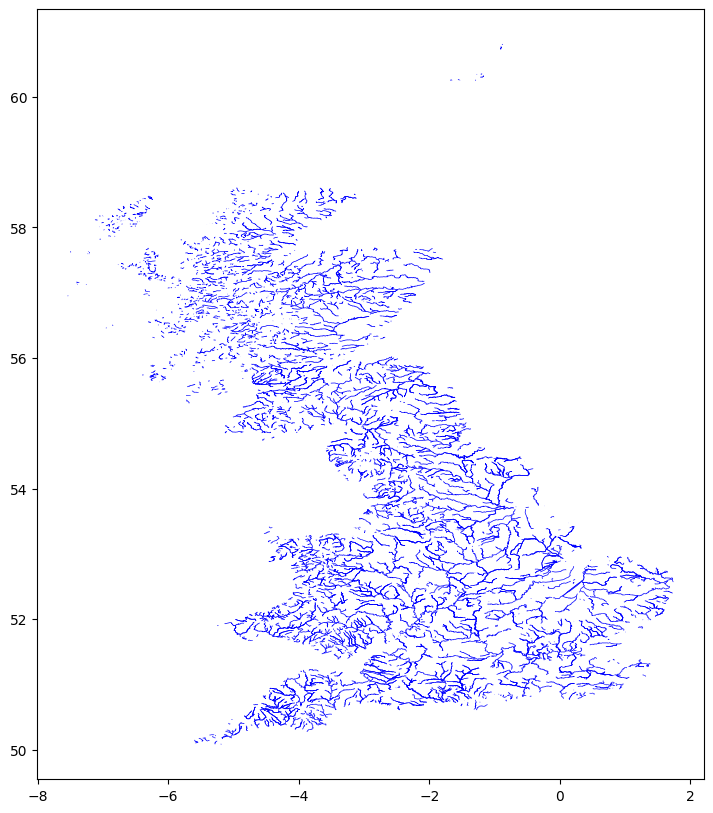

In [7]:
import matplotlib.pyplot as plt

# Configurar el tamaño del gráfico
plt.figure(figsize=(10, 10))

# Graficar los ríos filtrados
filtered_rivers.plot(ax=plt.gca(), color='blue', linewidth=0.5)

In [8]:
filtered_rivers.name.value_counts() # muchos con un mismo nombre

name
River Thames          546
River Avon            380
River Tove            280
River Frome           244
River Stour           227
                     ... 
Cooks Backwater         1
Garkie's Mill Lade      1
Lugate Water            1
Boondreigh Water        1
Kesgaig River           1
Name: count, Length: 3272, dtype: int64

In [9]:
filtered_rivers.dissolve(by='name')

,geometry
name,
A' Ghairbhe,"MULTILINESTRING ((-5.343 57.563, -5.344 57.565..."
A' Phait,"LINESTRING (-4.886 57.610, -4.885 57.609, -4.8..."
Abainn Rangail,"MULTILINESTRING ((-6.369 56.976, -6.369 56.976..."
Abainn Srath Ascaig,"LINESTRING (-5.540 57.339, -5.544 57.339, -5.5..."
Abberd Brook,"LINESTRING (-1.988 51.441, -1.989 51.441, -1.9..."
...,...
avon,"MULTILINESTRING ((-1.708 52.184, -1.708 52.184..."
e Dhomhain,"LINESTRING (-4.265 56.846, -4.265 56.846, -4.2..."
old mill goit,"LINESTRING (-1.533 53.909, -1.532 53.909, -1.5..."


In [10]:
filtered_rivers_dissolved = filtered_rivers.dissolve(by='name')
rivers_4326 = filtered_rivers_dissolved.reset_index()
rivers_4326.set_crs(epsg=4326, inplace=True, allow_override=True) # de acuerdo a sus coords
rivers_27700 = rivers_4326.to_crs(27700)

escoger a los más largos:

In [11]:
rivers_27700['length'] = rivers_27700.geometry.length
rivers_27700

,name,geometry,length
0,A' Ghairbhe,"MULTILINESTRING ((200111.287 857483.501, 20011...",6485.627138
1,A' Phait,"LINESTRING (227709.258 861393.222, 227762.352 ...",253.797301
2,Abainn Rangail,"MULTILINESTRING ((134638.068 795671.479, 13462...",2114.161415
3,Abainn Srath Ascaig,"LINESTRING (187038.580 833163.050, 186816.943 ...",1385.630855
4,Abberd Brook,"LINESTRING (400906.211 171338.935, 400884.103 ...",1031.022717
...,...,...,...
3267,avon,"MULTILINESTRING ((420063.177 254053.014, 42006...",118.599844
3268,e Dhomhain,"LINESTRING (261958.609 775040.023, 261970.609 ...",4712.571418
3269,old mill goit,"LINESTRING (430797.097 445950.343, 430814.951 ...",347.724695
3270,sence,"MULTILINESTRING ((459421.864 297243.297, 45944...",3676.723847


In [12]:
rivers_sorted = rivers_27700.sort_values(by='length', ascending=False)
longest_rivers_27700 = rivers_sorted.head(15)
longest_rivers_27700

,name,geometry,length
2115,River Avon,"MULTILINESTRING ((416370.634 117850.427, 41637...",537927.236718
2761,River Thames,"MULTILINESTRING ((459675.517 180847.117, 45967...",350897.120340
2682,River Severn,"MULTILINESTRING ((373366.200 211267.798, 37329...",326450.311161
2722,River Stour,"MULTILINESTRING ((632950.555 158519.407, 63295...",318856.421150
2266,River Dee,"MULTILINESTRING ((331760.699 339517.608, 33180...",309110.609724
2853,River Wye,"MULTILINESTRING ((489602.377 186562.954, 48956...",292297.060518
2271,River Derwent,"MULTILINESTRING ((443855.667 331720.970, 44383...",283201.140930
2787,River Trent,"MULTILINESTRING ((398267.680 325421.202, 39827...",272575.103101
2282,River Don,"MULTILINESTRING ((429280.763 398799.321, 42927...",245148.653223
2758,River Test,"MULTILINESTRING ((435558.653 115739.584, 43556...",235050.804979


<Axes: >

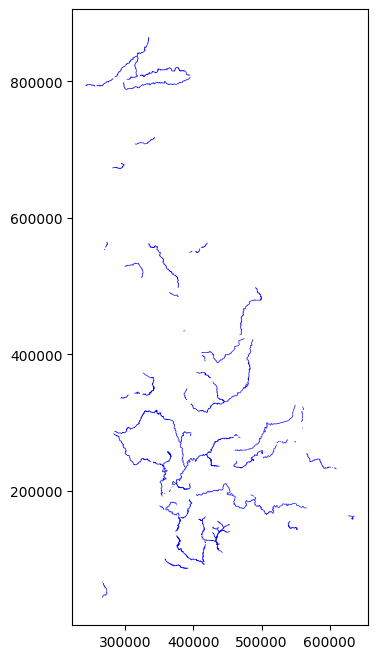

In [13]:
# Configurar el tamaño del gráfico
plt.figure(figsize=(8, 8))

# Graficar los ríos filtrados
longest_rivers_27700.plot(ax=plt.gca(), color='blue', linewidth=0.5)

## Seaports

In [14]:
import pandas as pd

portsFileLink="https://github.com/tatiana4321/GeoDFs_Analytics/raw/main/UpdatedPub150.csv"
infoseaports=pd.read_csv(portsFileLink)

#columns available (so many)
infoseaports.columns.to_list()

['OID_',
 'World Port Index Number',
 'Region Name',
 'Main Port Name',
 'Alternate Port Name',
 'UN/LOCODE',
 'Country Code',
 'World Water Body',
 'IHO S-130 Sea Area',
 'Sailing Direction or Publication',
 'Publication Link',
 'Standard Nautical Chart',
 'IHO S-57 Electronic Navigational Chart',
 'IHO S-101 Electronic Navigational Chart',
 'Digital Nautical Chart',
 'Tidal Range (m)',
 'Entrance Width (m)',
 'Channel Depth (m)',
 'Anchorage Depth (m)',
 'Cargo Pier Depth (m)',
 'Oil Terminal Depth (m)',
 'Liquified Natural Gas Terminal Depth (m)',
 'Maximum Vessel Length (m)',
 'Maximum Vessel Beam (m)',
 'Maximum Vessel Draft (m)',
 'Offshore Maximum Vessel Length (m)',
 'Offshore Maximum Vessel Beam (m)',
 'Offshore Maximum Vessel Draft (m)',
 'Harbor Size',
 'Harbor Type',
 'Harbor Use',
 'Shelter Afforded',
 'Entrance Restriction - Tide',
 'Entrance Restriction - Heavy Swell',
 'Entrance Restriction - Ice',
 'Entrance Restriction - Other',
 'Overhead Limits',
 'Underkeel Clearan

In [15]:
#rename
infoseaports.rename(columns={'Main Port Name':'portName', 'Country Code':'countryCode'},inplace=True)

#keep few columns
infoseaports=infoseaports.loc[:,['portName', 'countryCode','Latitude', 'Longitude']]

infoseaports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3801 entries, 0 to 3800
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   portName     3801 non-null   object 
 1   countryCode  3801 non-null   object 
 2   Latitude     3801 non-null   float64
 3   Longitude    3801 non-null   float64
dtypes: float64(2), object(2)
memory usage: 118.9+ KB


In [16]:
infoseaports.head()

,portName,countryCode,Latitude,Longitude
0,Maurer,United States,40.533333,-74.250000
1,Iharana,Madagascar,-13.350000,50.000000
2,Andoany,Madagascar,-13.400000,48.300000
3,Chake Chake,Tanzania,-5.250000,39.766667
4,Mjimwema Terminal,Tanzania,-6.816667,39.366667


Turning the points into projected spatial object (GDF of points)

In [17]:
#spatial points (unprojected)
seaports=gpd.GeoDataFrame(data=infoseaports.copy(),
                           geometry=gpd.points_from_xy(infoseaports.Longitude,
                                                       infoseaports.Latitude),
                          crs=4326)

# keep uk
seaports_uk=seaports[seaports['countryCode']=='United Kingdom'].copy()

# reset indexes
seaports_uk.reset_index(drop=True, inplace=True)

In [18]:
seaports_uk.crs # not uk

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [19]:
# reprojecting
seaports_uk_27700=seaports_uk.to_crs(27700) # projected crs

In [20]:
seaports_uk_27700.crs #checking

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

## Small Airports

In [21]:
airports.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1142 entries, 0 to 1141
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   name           1142 non-null   object  
 1   kind           1142 non-null   object  
 2   latitude_deg   1142 non-null   float64 
 3   longitude_deg  1142 non-null   float64 
 4   elevation_ft   433 non-null    float64 
 5   iso_region     1142 non-null   object  
 6   municipality   724 non-null    object  
 7   geometry       1142 non-null   geometry
dtypes: float64(3), geometry(1), object(4)
memory usage: 71.5+ KB


In [22]:
smallAirports=airports[airports['kind']=='small_airport']
smallAirports

,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
0,Cark airfield,small_airport,54.163753,-2.962299,20.0,GB-ENG,Cark,POINT (337266.334 474644.531)
1,Badminton Airfield,small_airport,51.548417,-2.303181,495.0,GB-ENG,Badminton,POINT (379073.734 183324.224)
2,Boon Hill Farm Airstrip,small_airport,54.308086,-0.983105,NaN,GB-ENG,"Fadmoor, Kirbymoorside",POINT (466262.484 490752.838)
3,Ledbury Airfield,small_airport,52.001900,-2.474160,250.0,GB-ENG,Ledbury,POINT (367545.998 233824.062)
4,Milfield Glider Field,small_airport,55.591636,-2.087231,NaN,GB-ENG,None,POINT (394600.512 633114.877)
...,...,...,...,...,...,...,...,...
1136,Out Skerries Airfield,small_airport,60.425200,-0.750000,76.0,GB-SCT,Grunay Island,POINT (468925.072 1171915.066)
1137,Papa Stour Airport,small_airport,60.321701,-1.693060,75.0,GB-SCT,Papa Stour Island,POINT (417054.691 1159774.295)
1138,Glenforsa Airfield,small_airport,56.517202,-5.914010,15.0,GB-SCT,Glenforsa,POINT (159326.623 742992.703)
1139,Broadford Airstrip,small_airport,57.253399,-5.827900,24.0,GB-SCT,Ashaig,POINT (169209.414 824571.040)


## Large Airports

In [23]:
airports.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1142 entries, 0 to 1141
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   name           1142 non-null   object  
 1   kind           1142 non-null   object  
 2   latitude_deg   1142 non-null   float64 
 3   longitude_deg  1142 non-null   float64 
 4   elevation_ft   433 non-null    float64 
 5   iso_region     1142 non-null   object  
 6   municipality   724 non-null    object  
 7   geometry       1142 non-null   geometry
dtypes: float64(3), geometry(1), object(4)
memory usage: 71.5+ KB


In [24]:
airports.crs # checking

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

In [25]:
largeAirports_27700=airports[airports['kind']=='large_airport']
largeAirports_27700.reset_index(drop=True, inplace=True)

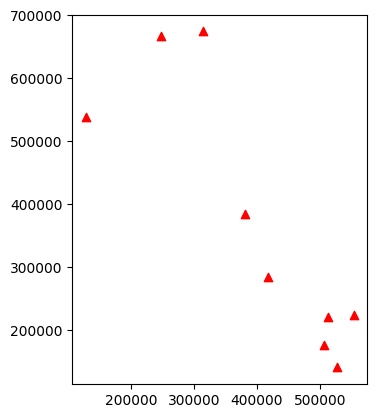

In [26]:
#plotting
base=largeAirports_27700.plot(color='red',marker="^")

# Exercise 1 (Distance between two points)

1. Use two maps of points from your country.

2. Compute the distance matrix for both maps.

3. Select one row of the distance matrix, and plot the two points with the minimal distance on top of the country of your choosing.

In [54]:
seaports_uk_27700.head()

,portName,countryCode,Latitude,Longitude,geometry
0,Mallaig,United Kingdom,57.000000,-5.816667,POINT (168307.354 796350.120)
1,Lochmaddy,United Kingdom,57.600000,-7.166667,POINT (91472.808 868427.897)
2,Lerwick,United Kingdom,60.167000,-1.150000,POINT (447272.648 1142808.423)
3,Burghead,United Kingdom,57.700000,-3.500000,POINT (310696.799 868787.732)
4,Buckie Harbor,United Kingdom,57.683333,-2.966667,POINT (342456.181 866353.738)


In [55]:
largeAirports_27700.head()

,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
0,Belfast International Airport,large_airport,54.657501,-6.215830,268.0,GB-NIR,Belfast,POINT (128198.290 537323.459)
1,Birmingham International Airport,large_airport,52.453899,-1.748030,327.0,GB-ENG,Birmingham,POINT (417219.887 284023.644)
2,Manchester Airport,large_airport,53.349375,-2.279521,257.0,GB-ENG,Manchester,POINT (381489.869 383645.942)
3,London Luton Airport,large_airport,51.874699,-0.368333,526.0,GB-ENG,"Luton, Bedfordshire",POINT (512423.792 220827.818)
4,London Gatwick Airport,large_airport,51.148771,-0.192089,202.0,GB-ENG,"Gatwick, Surrey",POINT (526550.011 140387.944)


Let's compute all possible distances between those GDFs

In [56]:
seaports_uk_27700.set_index('portName').geometry.apply\
(lambda g: largeAirports_27700.set_index('name').geometry.distance(g)/1000)

name,Belfast International Airport,Birmingham International Airport,Manchester Airport,London Luton Airport,London Gatwick Airport,London Heathrow Airport,Glasgow International Airport,Edinburgh Airport,London Stansted Airport
portName,,,,,,,,,
Mallaig,262.113617,569.592721,464.512135,670.553536,747.411652,706.972809,151.874623,190.648460,690.897776
Lochmaddy,333.134972,669.058659,564.910116,772.389535,848.135805,807.717720,255.028475,295.893681,793.936865
Lerwick,684.412512,859.310459,762.007248,924.279670,1005.550454,968.899103,515.922378,487.405874,925.895013
Burghead,378.383760,594.387253,490.279731,678.635270,759.709720,720.285283,211.362477,194.960080,690.000669
Buckie Harbor,392.641526,587.109828,484.283435,667.527305,748.943837,709.920767,220.674655,194.524446,677.143280
...,...,...,...,...,...,...,...,...,...
Kilroot,33.287914,365.094251,272.739435,477.516539,544.616649,505.322093,150.719016,201.165723,507.420644
Belfast,20.903550,365.529754,276.165356,478.712132,544.169481,505.217054,168.043918,218.691134,509.620756
Kilkeel,69.325510,333.743937,256.699009,448.013287,507.775698,470.152416,225.848239,269.532038,481.962557


In [57]:
#Reording previous output
seaports_uk_27700.set_index('portName').geometry.apply\
(lambda g: largeAirports_27700.set_index('name').geometry.distance(g)/1000).sort_index(axis=0).sort_index(axis=1)

name,Belfast International Airport,Birmingham International Airport,Edinburgh Airport,Glasgow International Airport,London Gatwick Airport,London Heathrow Airport,London Luton Airport,London Stansted Airport,Manchester Airport
portName,,,,,,,,,
Aberdeen,379.088614,523.017936,155.295960,202.857892,679.037078,640.666937,597.386799,604.735262,423.143398
Ardglass,58.353750,327.039697,235.851233,194.052532,504.421460,465.860022,440.868376,473.012680,242.329486
Ardrishaig,158.982469,464.015697,129.886301,65.555939,643.485327,603.105523,568.640397,591.739802,360.378459
Ardrossan,142.031163,408.393526,96.534318,34.499429,587.409431,546.998813,512.100552,534.888226,304.192189
Aultbea,355.905842,646.496167,249.224478,229.418749,821.210826,780.909995,742.397595,759.511194,540.683434
...,...,...,...,...,...,...,...,...,...
Whitstable,608.402759,226.361532,587.015034,617.732059,88.910403,104.651106,112.324828,79.890366,315.492874
Wick,462.381274,670.765330,277.002816,296.633585,831.498351,792.671100,749.971226,758.602266,568.066974
Wisbech,475.272768,130.838896,431.185021,464.904345,170.497504,139.517929,94.945912,87.163247,179.845160


In [29]:
# Saving it

distanceMatrixKM_sea_air= seaports_uk_27700.set_index('portName').geometry.apply\
                          (lambda g: largeAirports_27700.set_index('name').geometry.distance(g)/1000).\
                          sort_index(axis=0).sort_index(axis=1)

Farthest airport to each seaport

In [59]:
# Farthest airport to each seaport
distanceMatrixKM_sea_air.idxmax(axis=1)

portName
Aberdeen                   London Gatwick Airport
Ardglass                   London Gatwick Airport
Ardrishaig                 London Gatwick Airport
Ardrossan                  London Gatwick Airport
Aultbea                    London Gatwick Airport
                                ...              
Whitstable          Glasgow International Airport
Wick                       London Gatwick Airport
Wisbech             Belfast International Airport
Workington                 London Gatwick Airport
Yarmouth Harbour    Glasgow International Airport
Length: 185, dtype: object

In [60]:
# Farthest seaport to each airport
distanceMatrixKM_sea_air.idxmax(axis=0)

name
Belfast International Airport                     Sullom Voe
Birmingham International Airport                  Sullom Voe
Edinburgh Airport                   St. Mary's (Scilly Isl.)
Glasgow International Airport       St. Mary's (Scilly Isl.)
London Gatwick Airport                            Sullom Voe
London Heathrow Airport                           Sullom Voe
London Luton Airport                              Sullom Voe
London Stansted Airport                           Sullom Voe
Manchester Airport                                Sullom Voe
dtype: object

Closest airport to each seaport

In [61]:
# Closest airport to each seaport
distanceMatrixKM_sea_air.idxmin(axis=1)

portName
Aberdeen                        Edinburgh Airport
Ardglass            Belfast International Airport
Ardrishaig          Glasgow International Airport
Ardrossan           Glasgow International Airport
Aultbea             Glasgow International Airport
                                ...              
Whitstable                London Stansted Airport
Wick                            Edinburgh Airport
Wisbech                   London Stansted Airport
Workington          Glasgow International Airport
Yarmouth Harbour           London Gatwick Airport
Length: 185, dtype: object

In [62]:
# Closest seaport to each airport
distanceMatrixKM_sea_air.idxmin(axis=0)

name
Belfast International Airport                    Belfast
Birmingham International Airport               Sharpness
Edinburgh Airport                   Hound Point Terminal
Glasgow International Airport                    Renfrew
London Gatwick Airport                  Shoreham Harbour
London Heathrow Airport                           London
London Luton Airport                              London
London Stansted Airport                       Colchester
Manchester Airport                            Manchester
dtype: object

Choosing a row:

In [78]:
distanceMatrixKM_sea_air.head(1)

name,Belfast International Airport,Birmingham International Airport,Edinburgh Airport,Glasgow International Airport,London Gatwick Airport,London Heathrow Airport,London Luton Airport,London Stansted Airport,Manchester Airport
portName,,,,,,,,,
Aberdeen,379.088614,523.017936,155.29596,202.857892,679.037078,640.666937,597.386799,604.735262,423.143398


In [79]:
# selecting the seaport
aberdeen_distances = distanceMatrixKM_sea_air.loc['Aberdeen']
# closest airport to the seaport
closest_airport = aberdeen_distances.idxmin()
min_distance = aberdeen_distances.min()

In [80]:
seaports = seaports_uk_27700.set_index('portName')
airports = largeAirports_27700.set_index('name')
uk = country[country.COUNTRY=='United Kingdom']

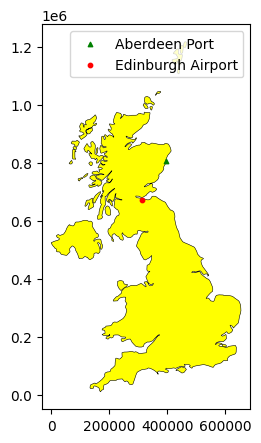

In [83]:
base = uk.plot(facecolor="yellow", edgecolor='black', linewidth=0.4,figsize=(5,5))
seaports.loc[['Aberdeen']].plot(ax=base, color='green', marker='^', markersize=10, label='Aberdeen Port')
airports.loc[[closest_airport]].plot(ax=base, color='red', markersize=10, label=closest_airport)
plt.legend()
plt.show()

# Exercise 2 (Distance between line and point)

1. Use a map of points and a map of lines from your country.

2. Compute the distance matrix for both.

3. Select one line of the distance matrix, and plot the closests and the farthest point to that line.

In [84]:
longest_rivers_27700

,name,geometry,length
2115,River Avon,"MULTILINESTRING ((416370.634 117850.427, 41637...",537927.236718
2761,River Thames,"MULTILINESTRING ((459675.517 180847.117, 45967...",350897.120340
2682,River Severn,"MULTILINESTRING ((373366.200 211267.798, 37329...",326450.311161
2722,River Stour,"MULTILINESTRING ((632950.555 158519.407, 63295...",318856.421150
2266,River Dee,"MULTILINESTRING ((331760.699 339517.608, 33180...",309110.609724
2853,River Wye,"MULTILINESTRING ((489602.377 186562.954, 48956...",292297.060518
2271,River Derwent,"MULTILINESTRING ((443855.667 331720.970, 44383...",283201.140930
2787,River Trent,"MULTILINESTRING ((398267.680 325421.202, 39827...",272575.103101
2282,River Don,"MULTILINESTRING ((429280.763 398799.321, 42927...",245148.653223
2758,River Test,"MULTILINESTRING ((435558.653 115739.584, 43556...",235050.804979


In [85]:
# Keeping one river
longest_rivers_27700[longest_rivers_27700.name.str.contains('Thames')]

,name,geometry,length
2761,River Thames,"MULTILINESTRING ((459675.517 180847.117, 45967...",350897.12034


<Axes: >

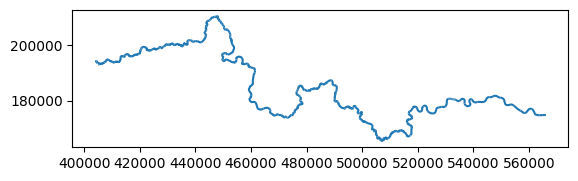

In [86]:
longest_rivers_27700[longest_rivers_27700.name.str.contains('Thames')].plot()

In [87]:
# Distance from each airport to
longest_rivers_27700[longest_rivers_27700.name.str.contains('Thames')].iloc[0].geometry.distance(largeAirports_27700.set_index('name').geometry)/1000

name
Belfast International Airport       440.206968
Birmingham International Airport     79.511878
Manchester Airport                  185.333343
London Luton Airport                 40.919783
London Gatwick Airport               28.539257
London Heathrow Airport               5.598833
Glasgow International Airport       497.919525
Edinburgh Airport                   482.229332
London Stansted Airport              41.743305
Name: geometry, dtype: float64

Computing all possible distances between the longest rivers and the airports

In [27]:
distanceMatrixKM_riv_air=longest_rivers_27700.set_index('name').geometry.apply\
(lambda g: largeAirports_27700.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0).sort_index(axis=1)

distanceMatrixKM_riv_air

name,Belfast International Airport,Birmingham International Airport,Edinburgh Airport,Glasgow International Airport,London Gatwick Airport,London Heathrow Airport,London Luton Airport,London Stansted Airport,Manchester Airport
name,,,,,,,,,
River Avon,204.832193,18.823282,16.332744,34.221145,109.571731,89.798249,72.063676,101.411099,121.616137
River Dee,141.900989,98.656426,115.224845,105.479766,276.651455,237.691391,212.550712,245.905394,43.259932
River Derwent,171.135915,54.499779,140.022635,146.969543,206.777366,166.619803,128.515428,152.539451,34.795699
River Don,277.882507,105.375241,133.867534,160.139673,263.372339,223.544506,183.449420,202.175948,35.890745
River Eden,206.698068,179.236756,34.012540,78.797128,15.060416,39.890996,72.010013,68.980417,114.016321
River Frome,364.877891,59.075737,418.843229,424.983442,144.754641,115.190043,117.346256,158.887111,127.215096
River Great Ouse,445.671556,61.361576,428.414109,464.656183,108.450126,68.016294,28.257237,48.454331,162.288493
River Nene,433.571380,50.191716,419.658945,450.132336,128.198473,88.713213,48.868880,74.542595,147.524937
River Severn,294.947141,38.055529,356.886504,359.436763,163.701226,131.305683,124.197411,165.378931,74.459136


In [89]:
# Sorting the distances from 'River Thames' to each airport

distanceMatrixKM_riv_air.loc['River Thames'].sort_values()

name
London Heathrow Airport               5.598833
London Gatwick Airport               28.539257
London Luton Airport                 40.919783
London Stansted Airport              41.743305
Birmingham International Airport     79.511878
Manchester Airport                  185.333343
Belfast International Airport       440.206968
Edinburgh Airport                   482.229332
Glasgow International Airport       497.919525
Name: River Thames, dtype: float64

In [90]:
!pip install mapclassify

In [91]:
thames_river = distanceMatrixKM_riv_air.loc['River Thames']
min = thames_river.idxmin()
max = thames_river.idxmax()

In [92]:
thames = longest_rivers_27700[longest_rivers_27700['name'] == 'River Thames'].copy()
closest_airport = largeAirports_27700[largeAirports_27700['name'] == min].copy()
farthest_airport = largeAirports_27700[largeAirports_27700['name'] == max].copy()

In [93]:
# Plotting the river and the closest and farthest airports
base=thames.explore(color='blue')
closest_airport.explore(m=base, color='red', marker_kwds=dict(radius=5))
farthest_airport.explore(m=base, color='green', marker_kwds=dict(radius=5))

# Exercise 3 (Polygon to point)

1. Create a HULL for some set of line map.

2. Compute the distance matrix between the HULLS and a map of points.

3. Plot the HULLS and the points. Show the closest and farthest points to the HULL.

In [94]:
country.centroid

0    POINT (348609.801 461152.220)
dtype: geometry

In [95]:
country.centroid.x.values[0],country.centroid.y.values[0]

(348609.8014521126, 461152.21989169234)

In [96]:
longest_rivers_27700

,name,geometry,length
2115,River Avon,"MULTILINESTRING ((416370.634 117850.427, 41637...",537927.236718
2761,River Thames,"MULTILINESTRING ((459675.517 180847.117, 45967...",350897.120340
2682,River Severn,"MULTILINESTRING ((373366.200 211267.798, 37329...",326450.311161
2722,River Stour,"MULTILINESTRING ((632950.555 158519.407, 63295...",318856.421150
2266,River Dee,"MULTILINESTRING ((331760.699 339517.608, 33180...",309110.609724
2853,River Wye,"MULTILINESTRING ((489602.377 186562.954, 48956...",292297.060518
2271,River Derwent,"MULTILINESTRING ((443855.667 331720.970, 44383...",283201.140930
2787,River Trent,"MULTILINESTRING ((398267.680 325421.202, 39827...",272575.103101
2282,River Don,"MULTILINESTRING ((429280.763 398799.321, 42927...",245148.653223
2758,River Test,"MULTILINESTRING ((435558.653 115739.584, 43556...",235050.804979


In [97]:
# coordinates
centroidX,centroidY=country.centroid.x.values[0],country.centroid.y.values[0]

In [98]:
uk_LriverNorth = longest_rivers_27700.cx[:, centroidY:]
uk_LriverSouth = longest_rivers_27700.cx[:, :centroidY]

In [99]:
uk_LriverNorth = longest_rivers_27700[longest_rivers_27700.geometry.centroid.y >= centroidY]
uk_LriverSouth = longest_rivers_27700[longest_rivers_27700.geometry.centroid.y < centroidY]

<Axes: >

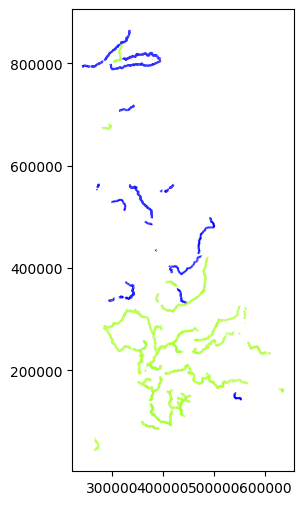

In [100]:
fig, ax = plt.subplots(figsize=(10, 6))
uk_LriverNorth.plot(ax=ax, color='blue', alpha=0.8)
uk_LriverSouth.plot(ax=ax, color='greenyellow', alpha=0.8)

### Intentando arreglar los colores

In [110]:
!pip install shapely

In [233]:
from shapely.geometry import LineString, MultiLineString, GeometryCollection
from shapely.ops import split

In [234]:
centroidX, centroidY = country.centroid.x.values[0], country.centroid.y.values[0]

In [235]:
# creando línea divisoria
division_line = LineString([(country.total_bounds[0], centroidY), (country.total_bounds[2], centroidY)])

In [236]:
# creando listas
north_segments = []
south_segments = []

In [237]:
def process_geometry(geom, division_line, centroidY):
    if geom.crosses(division_line):
        # dividir la geometría
        split_geoms = split(geom, division_line)
        # asegurarse de que split_geoms es una lista de geometrías
        if isinstance(split_geoms, (GeometryCollection, MultiLineString)):
            split_geoms = list(split_geoms.geoms)
        else:
            split_geoms = [split_geoms]
        for part in split_geoms:
            if part.centroid.y >= centroidY:
                north_segments.append(part)
            else:
                south_segments.append(part)
    else:
        if geom.centroid.y >= centroidY:
            north_segments.append(geom)
        else:
            south_segments.append(geom)

In [238]:
for geom in longest_rivers_27700.geometry:
    if isinstance(geom, MultiLineString):
        for part in geom.geoms:
            process_geometry(part, division_line, centroidY)
    else:
        process_geometry(geom, division_line, centroidY)

In [239]:
north_gdf = gpd.GeoDataFrame(geometry=north_segments, crs=longest_rivers_27700.crs)
south_gdf = gpd.GeoDataFrame(geometry=south_segments, crs=longest_rivers_27700.crs)

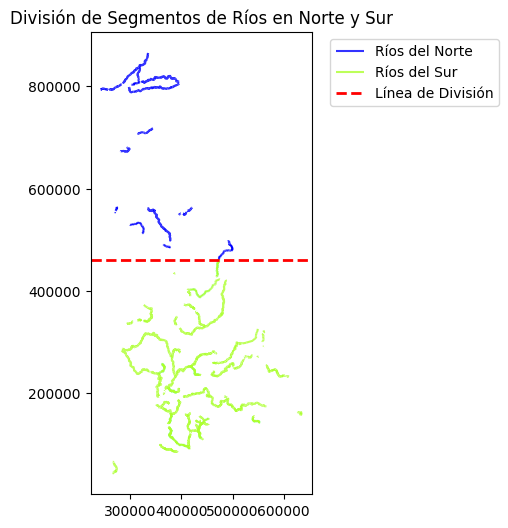

In [247]:
fig, ax = plt.subplots(figsize=(10, 6))
north_gdf.plot(ax=ax, color='blue', alpha=0.8, label='Ríos del Norte')
south_gdf.plot(ax=ax, color='greenyellow', alpha=0.8, label='Ríos del Sur')
plt.axhline(y=centroidY, color='red', linestyle='--', linewidth=2, label='Línea de División')
plt.title('División de Segmentos de Ríos en Norte y Sur')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left') # para que se vea el mapa
plt.show()

### Continuando con el ejercicio

Creando los hulls

<Axes: >

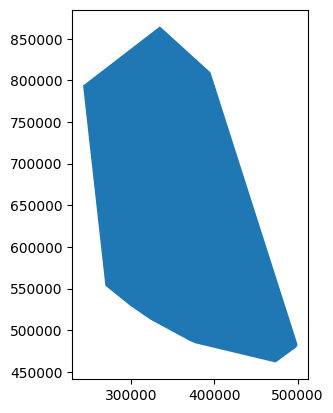

In [319]:
north_gdf.dissolve().convex_hull.plot()

<Axes: >

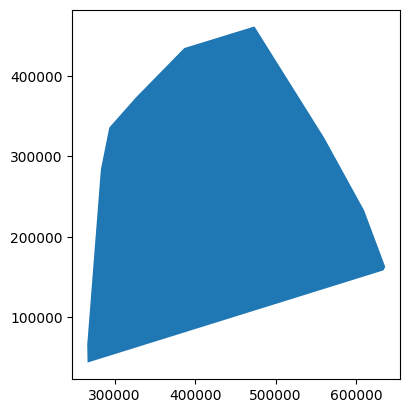

In [320]:
south_gdf.dissolve().convex_hull.plot()

In [321]:
uk_RNorth = north_gdf.unary_union.convex_hull
uk_RSouth = south_gdf.unary_union.convex_hull

<Axes: >

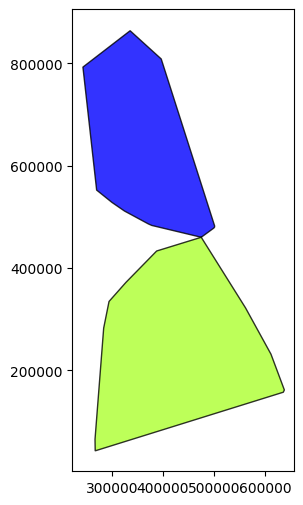

In [322]:
fig, ax = plt.subplots(figsize=(10, 6))
gpd.GeoSeries(uk_RNorth).plot(ax=ax, color='blue', alpha=0.8, edgecolor='black')
gpd.GeoSeries(uk_RSouth).plot(ax=ax, color='greenyellow', alpha=0.8, edgecolor='black')

In [323]:
combined_hulls = gpd.GeoDataFrame(
    {'region': ['north', 'south'],
     'geometry': [uk_RNorth, uk_RSouth]},
    crs="EPSG:27700"
).set_index('region')

In [342]:
some_seaports = seaports_uk_27700.tail(8) # selecting some
distanceMatrixKM_rivHull_sea = combined_hulls.geometry.apply(
    lambda g: some_seaports.set_index('portName').geometry.distance(g) / 1000
)
distanceMatrixKM_rivHull_sea

portName,Sharpness,Rothesay Dock,Faslane,Kilroot,Belfast,Kilkeel,Larne,Warren Point
region,,,,,,,,
north,276.814699,6.093190,29.279016,108.744108,122.826872,154.875247,111.903169,166.297680
south,0.000000,272.445464,302.092837,237.958183,238.541648,203.684299,250.563575,221.053637


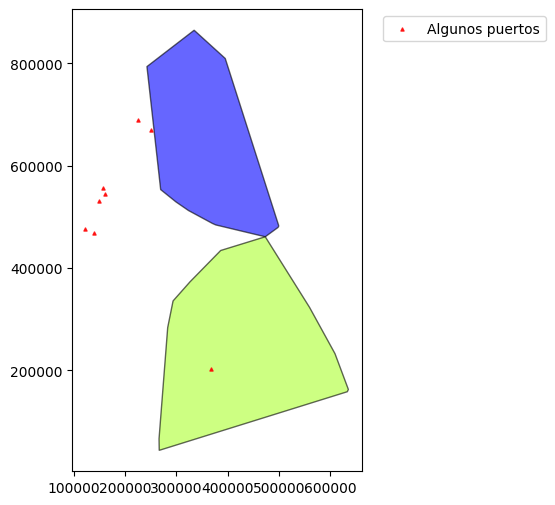

In [343]:
fig, ax = plt.subplots(figsize=(10, 6))
combined_hulls.plot(ax=ax, color=['blue', 'greenyellow'], alpha=0.6, edgecolor='black', legend=True)
some_seaports.plot(ax=ax, color='red', alpha=0.8, marker='^', markersize=5, label='Algunos puertos')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [344]:
mins=distanceMatrixKM_rivHull_sea.idxmin(axis="columns")
mins

region
north    Rothesay Dock
south        Sharpness
dtype: object

In [346]:
# plotting
base=combined_hulls.explore()
some_seaports[some_seaports.portName.isin(mins)].explore(m=base,color='yellow',marker_kwds=dict(radius=15)) #closest
some_seaports[~some_seaports.portName.isin(mins)].explore(m=base,color='crimson',marker_kwds=dict(radius=5)) #farthest

# Exercise 4

1. Select a line map and a point one.

2. Get the buffer for the lines, select a distance.

3. Keep the points that are within the buffer (you might need to play with differnt distances until you show something interesting).  
    

Longest Rivers and Small Airports

In [28]:
distanceMatrixKM_riv_air

name,Belfast International Airport,Birmingham International Airport,Edinburgh Airport,Glasgow International Airport,London Gatwick Airport,London Heathrow Airport,London Luton Airport,London Stansted Airport,Manchester Airport
name,,,,,,,,,
River Avon,204.832193,18.823282,16.332744,34.221145,109.571731,89.798249,72.063676,101.411099,121.616137
River Dee,141.900989,98.656426,115.224845,105.479766,276.651455,237.691391,212.550712,245.905394,43.259932
River Derwent,171.135915,54.499779,140.022635,146.969543,206.777366,166.619803,128.515428,152.539451,34.795699
River Don,277.882507,105.375241,133.867534,160.139673,263.372339,223.544506,183.449420,202.175948,35.890745
River Eden,206.698068,179.236756,34.012540,78.797128,15.060416,39.890996,72.010013,68.980417,114.016321
River Frome,364.877891,59.075737,418.843229,424.983442,144.754641,115.190043,117.346256,158.887111,127.215096
River Great Ouse,445.671556,61.361576,428.414109,464.656183,108.450126,68.016294,28.257237,48.454331,162.288493
River Nene,433.571380,50.191716,419.658945,450.132336,128.198473,88.713213,48.868880,74.542595,147.524937
River Severn,294.947141,38.055529,356.886504,359.436763,163.701226,131.305683,124.197411,165.378931,74.459136


In [29]:
longest_rivers_27700[longest_rivers_27700.name.str.contains('Thames')]

,name,geometry,length
2761,River Thames,"MULTILINESTRING ((459675.517 180847.117, 45967...",350897.12034


In [30]:
distanceMatrixKM_riv_air.loc['River Thames'].min()
minD=distanceMatrixKM_riv_air.loc['River Thames'].min()*1000

In [31]:
longest_rivers_27700[longest_rivers_27700.name=='River Thames'].buffer(distance = minD)

2761    POLYGON ((407160.536 187786.469, 406714.779 18...
dtype: geometry

In [32]:
bufferAroundThames=rivers_27700[rivers_27700.name=='River Thames'].buffer(distance = minD)
bufferAsBase=bufferAroundThames.explore(color='red')

In [33]:
longest_rivers_27700[longest_rivers_27700.name=='River Thames'].explore(m=bufferAsBase,color='blue',style_kwds={'weight':0.5})
smallAirports.explore(m=bufferAsBase,color='black')

In [34]:
riversWithinBuffer=smallAirports.clip(mask=bufferAroundThames)
riversWithinBuffer

,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
203,Oaksey Park Airport,small_airport,51.632198,-2.014720,250.0,GB-ENG,Malmesbury,POINT (399077.857 192598.714)
286,Steventon Private Airstrip,small_airport,51.621133,-1.333915,NaN,GB-ENG,None,POINT (446209.909 191577.892)
1054,Hamilton House Airstrip,small_airport,51.663785,-1.446633,NaN,GB-ENG,Charney,POINT (438370.565 196256.496)
781,Inglesham Private Airstrip,small_airport,51.669934,-1.716056,NaN,GB-ENG,None,POINT (419733.200 196833.647)
205,RAF Abingdon,small_airport,51.690300,-1.316670,259.0,GB-ENG,Abingdon,POINT (447331.846 199281.506)
913,South Cerney Airfield,small_airport,51.687200,-1.920400,364.0,GB-ENG,South Cerney (Glos),POINT (405599.453 198718.853)
113,White Waltham Airfield,small_airport,51.500801,-0.774444,131.0,GB-ENG,Maidenhead,POINT (485165.383 178696.654)
628,Whittles Farm Airstrip,small_airport,51.500485,-1.035757,NaN,GB-ENG,None,POINT (467027.918 178390.240)
634,North Moreton Airstrip,small_airport,51.603506,-1.184651,NaN,GB-ENG,None,POINT (456565.210 189722.177)
549,Drayton St. Leonard,small_airport,51.664100,-1.126930,NaN,GB-ENG,None,POINT (460482.224 196507.362)


In [35]:
# plotting the airports within buffer
bufferAsBase=bufferAroundThames.explore(color='red')
longest_rivers_27700[longest_rivers_27700.name=='River Thames'].explore(m=bufferAsBase,color='blue',style_kwds={'weight':0.5})
riversWithinBuffer.explore(m=bufferAsBase,color='black')

In [36]:
# minimum of all the minimum by row
distanceMatrixKM_riv_air.min(axis=1).min()

5.598833353982658

In [37]:
# using the previous value
minMin=distanceMatrixKM_riv_air.min(axis=1).min()*100

In [38]:
MinBuffer=longest_rivers_27700.buffer(distance = minMin).explore(color='red')
longest_rivers_27700.explore(m=MinBuffer,color='blue',style_kwds={'weight':0.5})

In [39]:
longrivers_buff=longest_rivers_27700.buffer(distance = minMin)
longrivers_buff

2115    MULTIPOLYGON (((465726.993 279235.707, 465724....
2761    POLYGON ((403864.963 194697.028, 403897.795 19...
2682    MULTIPOLYGON (((284490.555 287807.677, 284497....
2722    MULTIPOLYGON (((627240.775 163869.125, 627256....
2266    MULTIPOLYGON (((298472.831 797422.399, 298500....
2853    MULTIPOLYGON (((489086.006 186951.192, 489086....
2271    MULTIPOLYGON (((467502.779 428650.788, 467505....
2787    MULTIPOLYGON (((396071.449 327403.325, 396052....
2282    MULTIPOLYGON (((411665.387 402437.158, 411684....
2758    POLYGON ((418276.432 128249.653, 418276.212 12...
2365    MULTIPOLYGON (((374602.856 209932.918, 374603....
2312    MULTIPOLYGON (((538401.423 151891.251, 538401....
2397    MULTIPOLYGON (((560736.034 318825.671, 560853....
2713    MULTIPOLYGON (((284634.027 807159.929, 284680....
2585    MULTIPOLYGON (((500194.978 282407.481, 500194....
dtype: geometry

In [40]:
longRiversWithinBuffs=smallAirports.clip(longrivers_buff)
longRiversWithinBuffs

,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
743,Marsh Court Manor Private Airstrip,small_airport,51.098725,-1.495085,NaN,GB-ENG,None,POINT (435451.848 133389.999)
1125,Lydeway Field,small_airport,51.194800,-1.553000,350.0,GB-ENG,None,POINT (431331.641 144048.214)
89,Thruxton Aerodrome,small_airport,51.210602,-1.600000,319.0,GB-ENG,Andover,POINT (428037.864 145786.632)
608,Avon Lane Airfield,small_airport,51.410210,-2.447792,NaN,GB-ENG,Saltford,POINT (368952.225 168005.027)
781,Inglesham Private Airstrip,small_airport,51.669934,-1.716056,NaN,GB-ENG,None,POINT (419733.200 196833.647)
622,Bycross Farm Airstrip,small_airport,52.077944,-2.907441,NaN,GB-ENG,Moccas,POINT (337907.625 242564.663)
456,Breidden Airfield,small_airport,52.702036,-3.092449,NaN,GB-WLS,Welshpool,POINT (326277.736 312156.017)
947,Grove Field Airstrip,small_airport,52.229000,-1.618530,NaN,GB-ENG,None,POINT (426151.926 259046.221)
756,Bericote Farm Airstrip,small_airport,52.327190,-1.547935,NaN,GB-ENG,Blackdown / Ashow,POINT (430905.530 269995.654)
245,Aboyne Airfield,small_airport,57.075556,-2.839444,463.0,GB-SCT,Aboyne,POINT (349207.111 798594.668)


<Axes: >

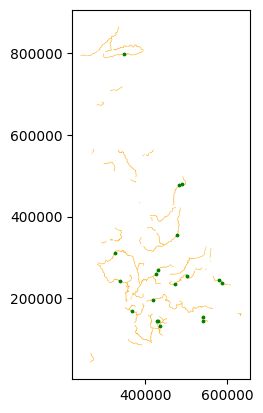

In [43]:
# simple
base=longrivers_buff.plot(color='orange')
longRiversWithinBuffs.plot(ax=base, color='green', markersize=3)

In [44]:
base=longrivers_buff.explore(color='orange')
longRiversWithinBuffs.explore(m=base, color='green')